In [20]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt 
import os
from pandas.tseries.holiday import USFederalHolidayCalendar
from glob import glob

import utils
# from utils import load_data, get_train_val_split, get_stratified_splitter
from sklearn.model_selection import StratifiedShuffleSplit, StratifiedGroupKFold, train_test_split, TimeSeriesSplit
from sklearn.metrics import mean_squared_error, make_scorer
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

from lightgbm import LGBMRegressor
from scipy.stats import kstest, kruskal, mannwhitneyu
from itertools import combinations
from collections import defaultdict
from tqdm import tqdm
from sklearn.ensemble import StackingRegressor
import re

import optuna
import pickle

In [2]:
import importlib
importlib.reload(utils)

<module 'utils' from 'C:\\Users\\johns\\Desktop\\probstats2\\EnergyPrediction-ASHRAE\\code\\utils.py'>

In [3]:
data_dict = utils.load_data('ashrae-energy-prediction')

Memory usage of dataframe is 0.07 MB
Memory usage after optimization is: 0.02 MB
Decreased by 73.88%


C:\Users\johns\Desktop\probstats2\EnergyPrediction-ASHRAE\code\utils.py:143: FutureWarning: Using .astype to convert from timezone-aware dtype to timezone-naive dtype is deprecated and will raise in a future version.  Use obj.tz_localize(None) or obj.tz_convert('UTC').tz_localize(None) instead
  weather_train['timestamp'] = pd.to_datetime(weather_train['timestamp'], infer_datetime_format = True, utc = True).astype('datetime64[ns]')


Memory usage of dataframe is 9.60 MB
Memory usage after optimization is: 3.07 MB
Decreased by 68.05%
Memory usage of dataframe is 19.04 MB
Memory usage after optimization is: 5.13 MB
Decreased by 73.04%


C:\Users\johns\Desktop\probstats2\EnergyPrediction-ASHRAE\code\utils.py:151: FutureWarning: Using .astype to convert from timezone-aware dtype to timezone-naive dtype is deprecated and will raise in a future version.  Use obj.tz_localize(None) or obj.tz_convert('UTC').tz_localize(None) instead
  train['timestamp'] = pd.to_datetime(train['timestamp'], infer_datetime_format = True, utc = True).astype('datetime64[ns]')


Memory usage of dataframe is 616.95 MB
Memory usage after optimization is: 289.19 MB
Decreased by 53.12%
Memory usage of dataframe is 1272.51 MB
Memory usage after optimization is: 358.53 MB
Decreased by 71.82%


C:\Users\johns\Desktop\probstats2\EnergyPrediction-ASHRAE\code\utils.py:166: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train[(train['site_id'] == 0) & (train['meter'] == 0)]['meter_reading'] = 0.2931 * train[(train['site_id'] == 0) & (train['meter'] == 0)]['meter_reading']


In [4]:
# Add weather features 
weather_features = ['cloud_coverage', 'dew_temperature', 'air_temperature', 
                    'sea_level_pressure', 'wind_direction', 'wind_speed', 'precip_depth_1_hr',]

hourly_by_site = data_dict["X_train"].groupby(['hour', 'month', 'site_id'])[weather_features].mean().reset_index()

data_dict["X_train"] = data_dict["X_train"].merge(
    hourly_by_site, 
    on=['hour', 'month', 'site_id'], 
    how='left', 
    suffixes=(None, '_hourly_by_site')
)

del hourly_by_site

for feature in weather_features:
    # Fill in NA values from weather with hourly by site columns 
    data_dict["X_train"][feature].fillna(
        data_dict["X_train"][feature + "_hourly_by_site"],
        inplace=True
    )
    
    # Fill in the rest with the median 
    data_dict["X_train"][feature].fillna(
        data_dict["X_train"][feature].median(),
        inplace=True
    )
    
    data_dict["X_train"][feature + "_diff_hourly_from_mean"] = data_dict["X_train"][feature] - \
        data_dict["X_train"][feature + "_hourly_by_site"]
    
data_dict["X_train"] = data_dict["X_train"].drop(columns = [feat + "_hourly_by_site" for feat in weather_features])

In [5]:
# Fill in NA with median values for floor count and year_built
for feature in ['year_built', 'floor_count']:
    data_dict["X_train"][feature].fillna(
        data_dict["X_train"][feature].median(), 
        inplace=True
    )

In [6]:
data_dict.keys()

dict_keys(['weather_test', 'X_train', 'X_test', 'y_train'])

In [7]:
features = ['year_built', 'floor_count', 'air_temperature',
       'cloud_coverage', 'dew_temperature', 'precip_depth_1_hr',
       'sea_level_pressure', 'wind_direction', 'wind_speed',
       'air_temperature_mean_lag7', 'air_temperature_max_lag7',
       'air_temperature_min_lag7', 'air_temperature_std_lag7',
       'cloud_coverage_mean_lag7', 'cloud_coverage_max_lag7',
       'cloud_coverage_min_lag7', 'cloud_coverage_std_lag7',
       'dew_temperature_mean_lag7', 'dew_temperature_max_lag7',
       'dew_temperature_min_lag7', 'dew_temperature_std_lag7',
       'precip_depth_1_hr_mean_lag7', 'precip_depth_1_hr_max_lag7',
       'precip_depth_1_hr_min_lag7', 'precip_depth_1_hr_std_lag7',
       'sea_level_pressure_mean_lag7', 'sea_level_pressure_max_lag7',
       'sea_level_pressure_min_lag7', 'sea_level_pressure_std_lag7',
       'wind_direction_mean_lag7', 'wind_direction_max_lag7',
       'wind_direction_min_lag7', 'wind_direction_std_lag7',
       'wind_speed_mean_lag7', 'wind_speed_max_lag7', 'wind_speed_min_lag7',
       'wind_speed_std_lag7', 'log_square_feet', 'weekday', 'hour', 'day',
       'weekend', 'month', 'primary_use_enc']

In [8]:
# Perform T-SNE per site per meter 

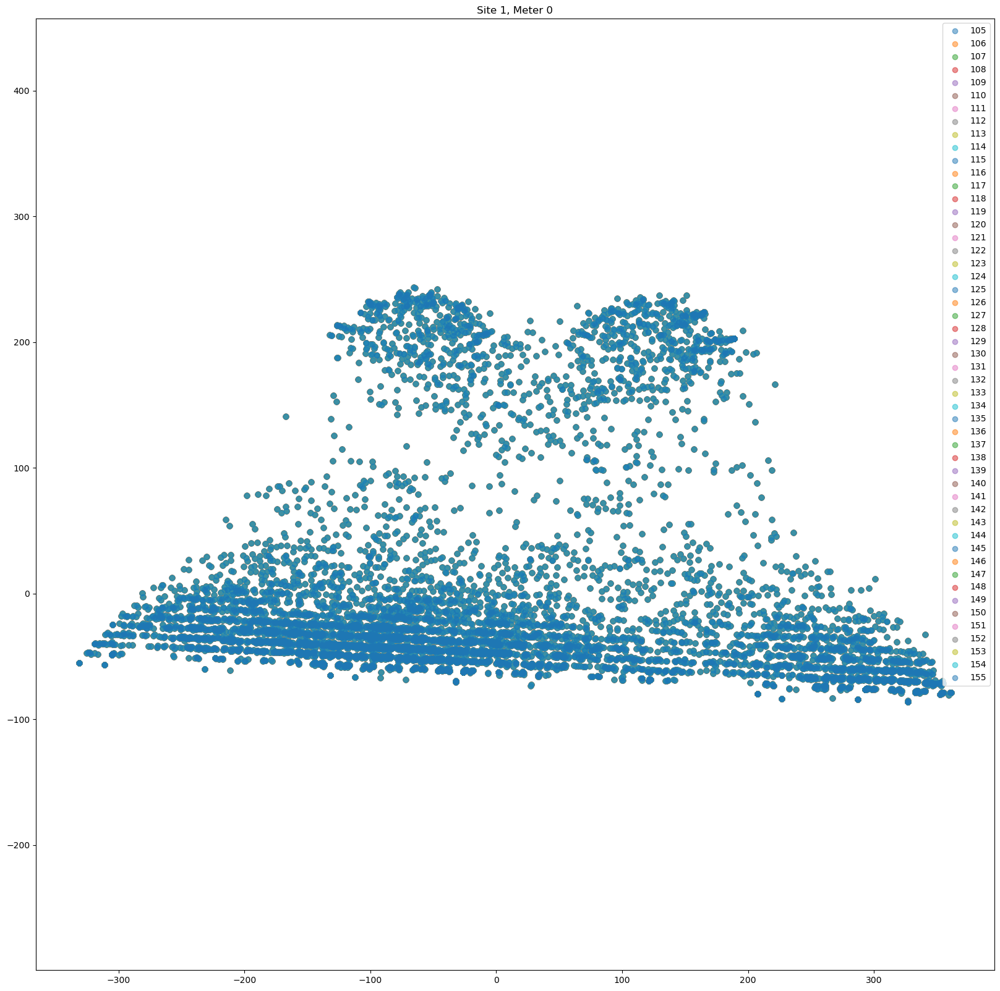

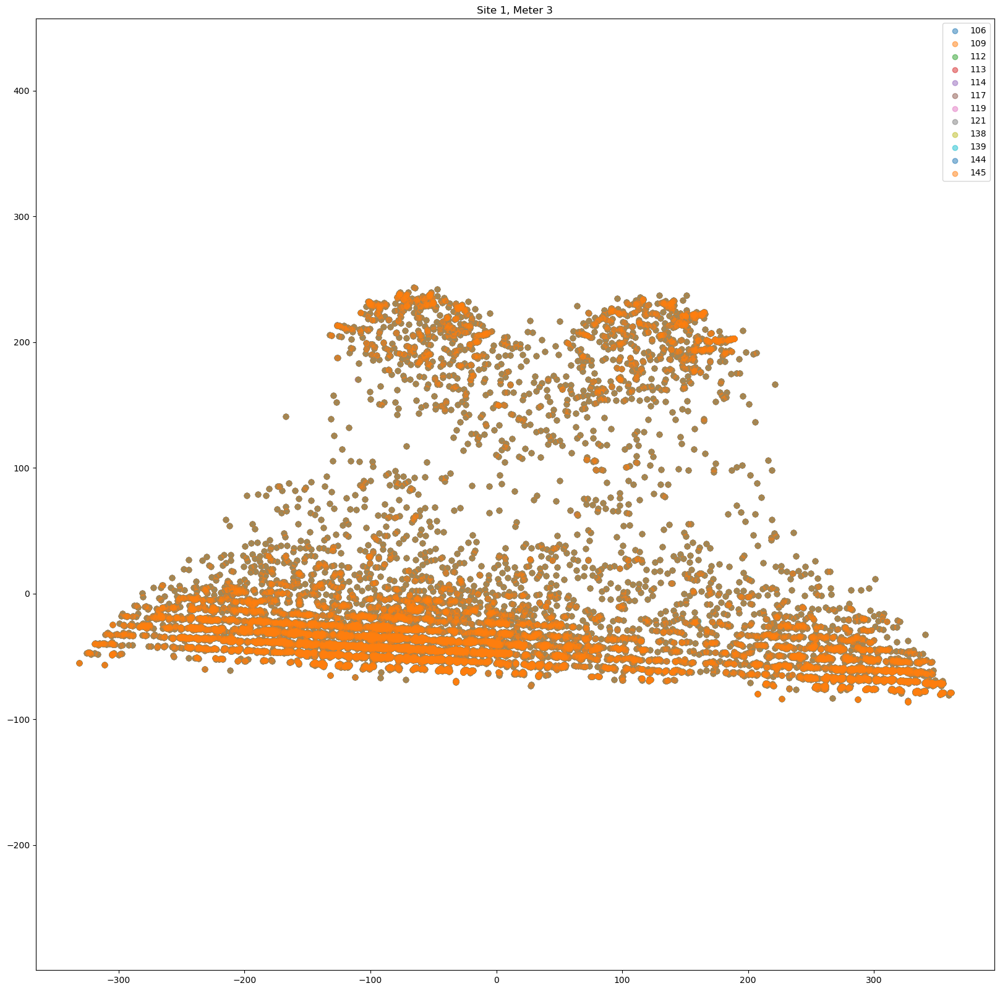

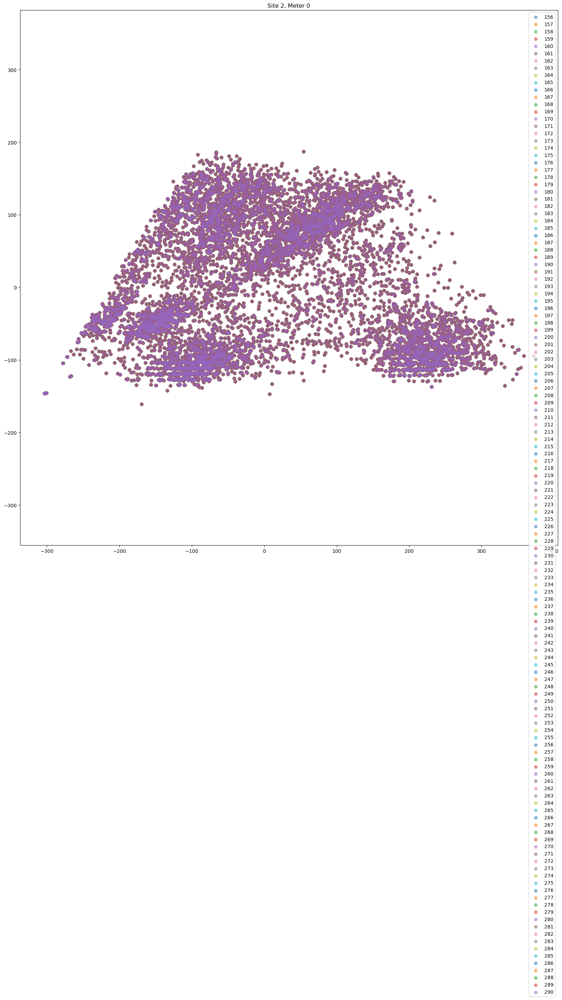

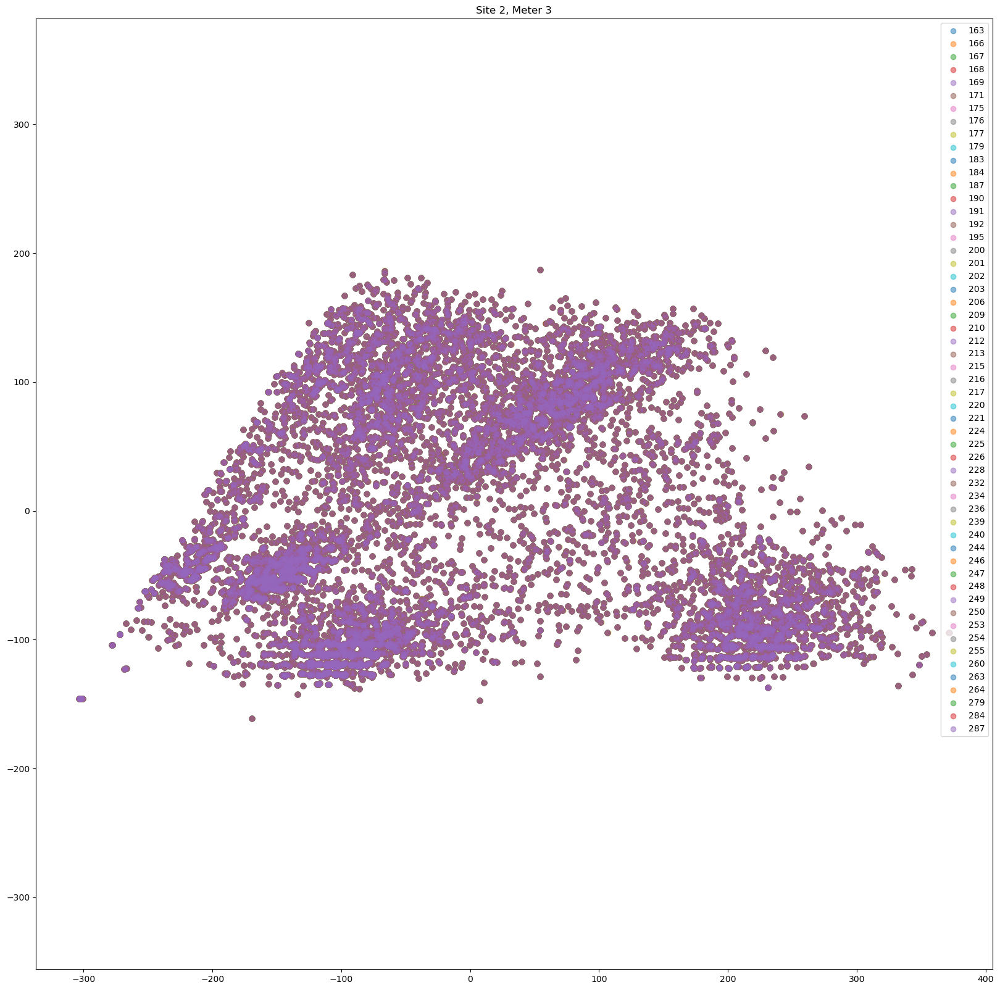

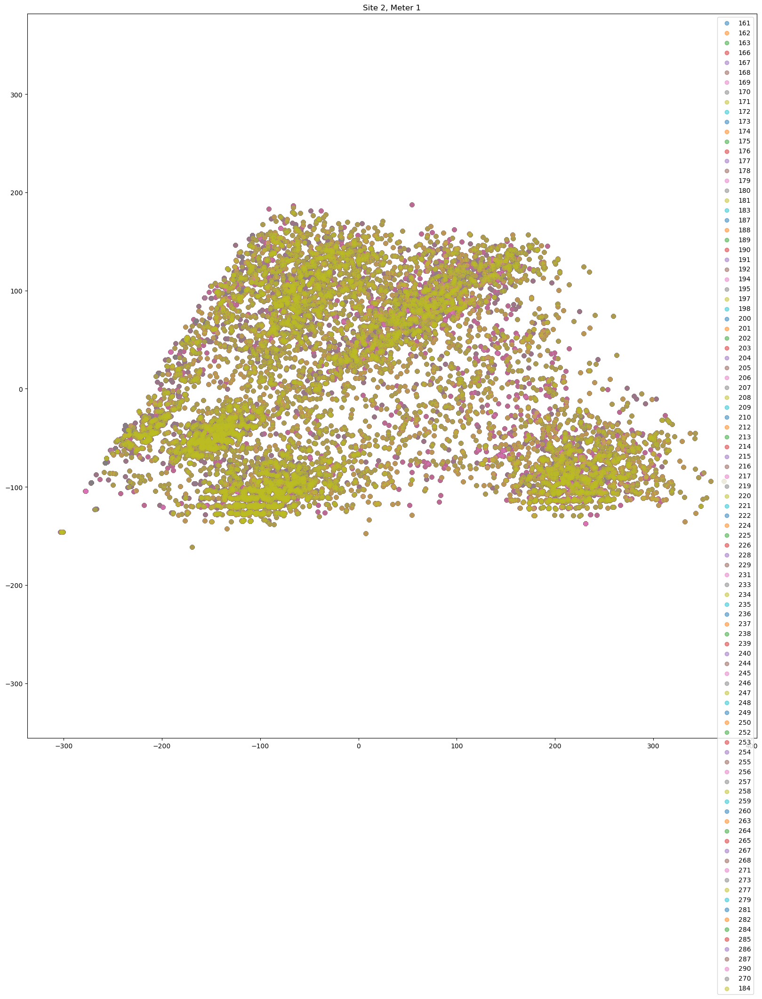

...

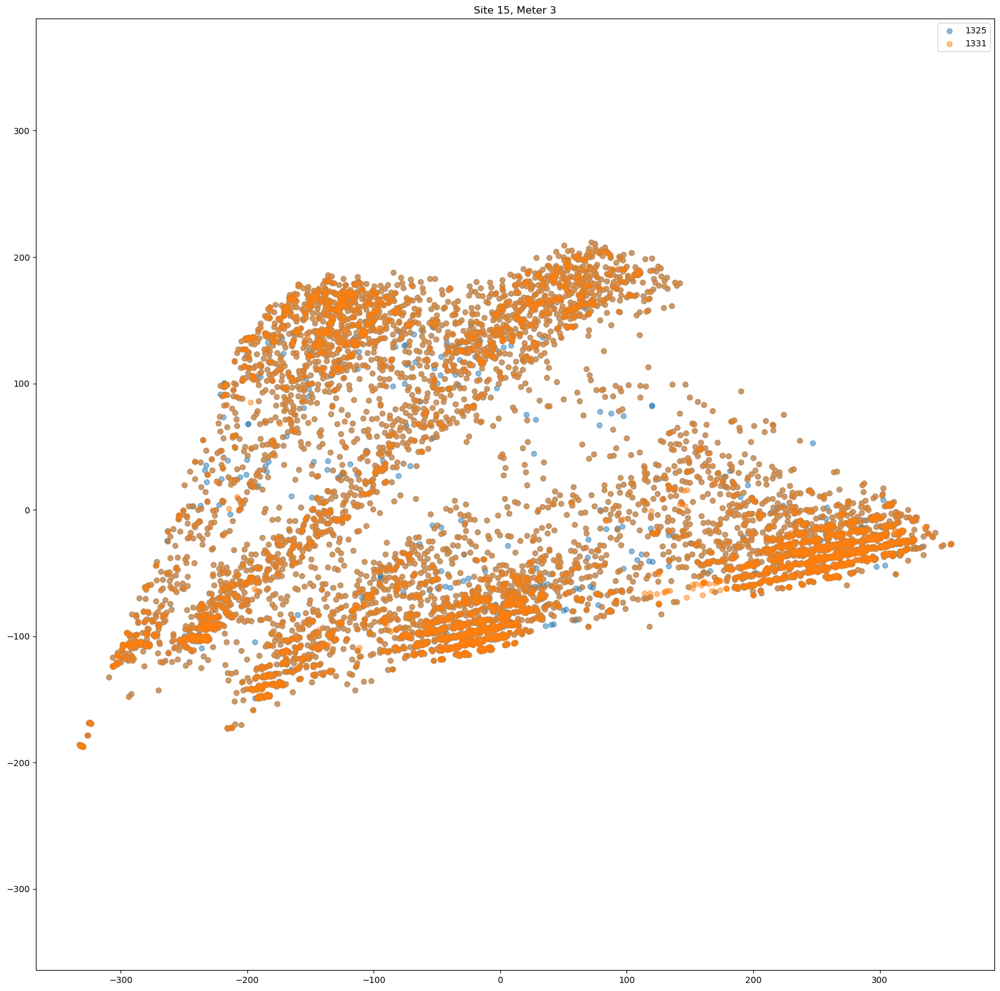

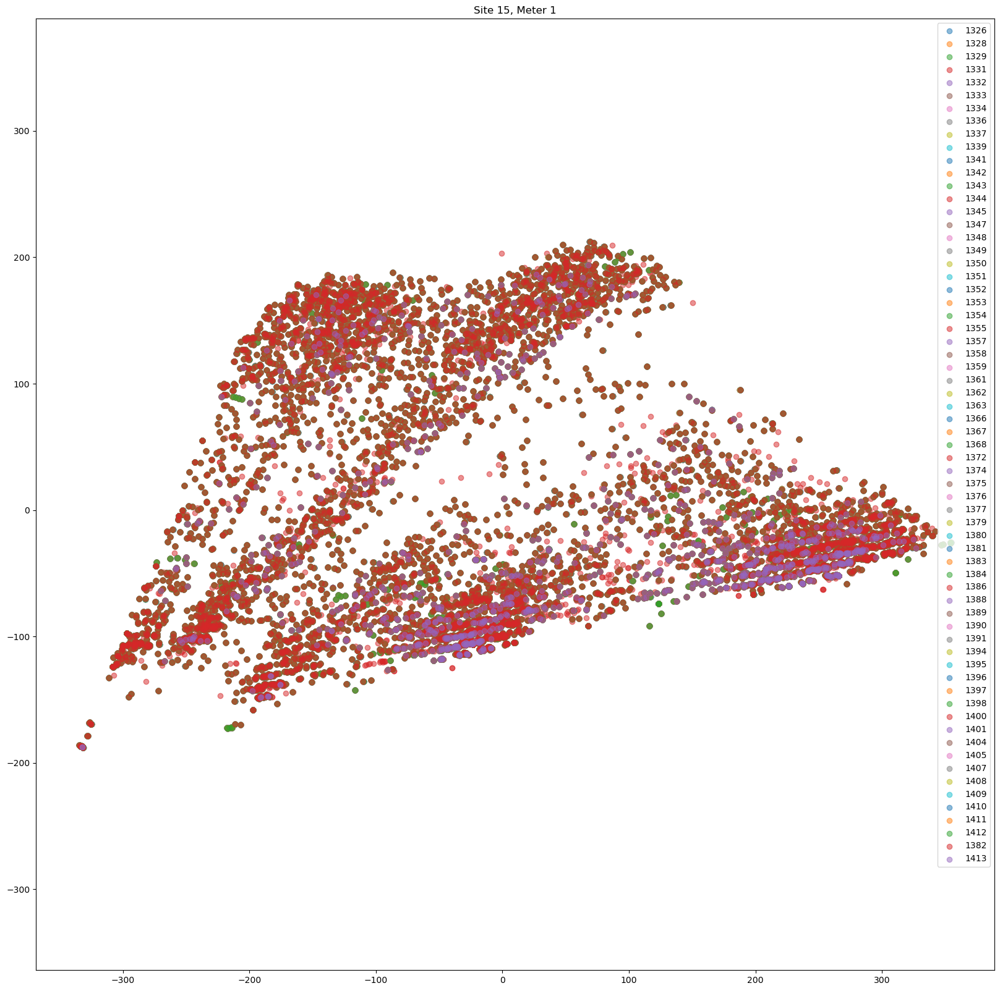

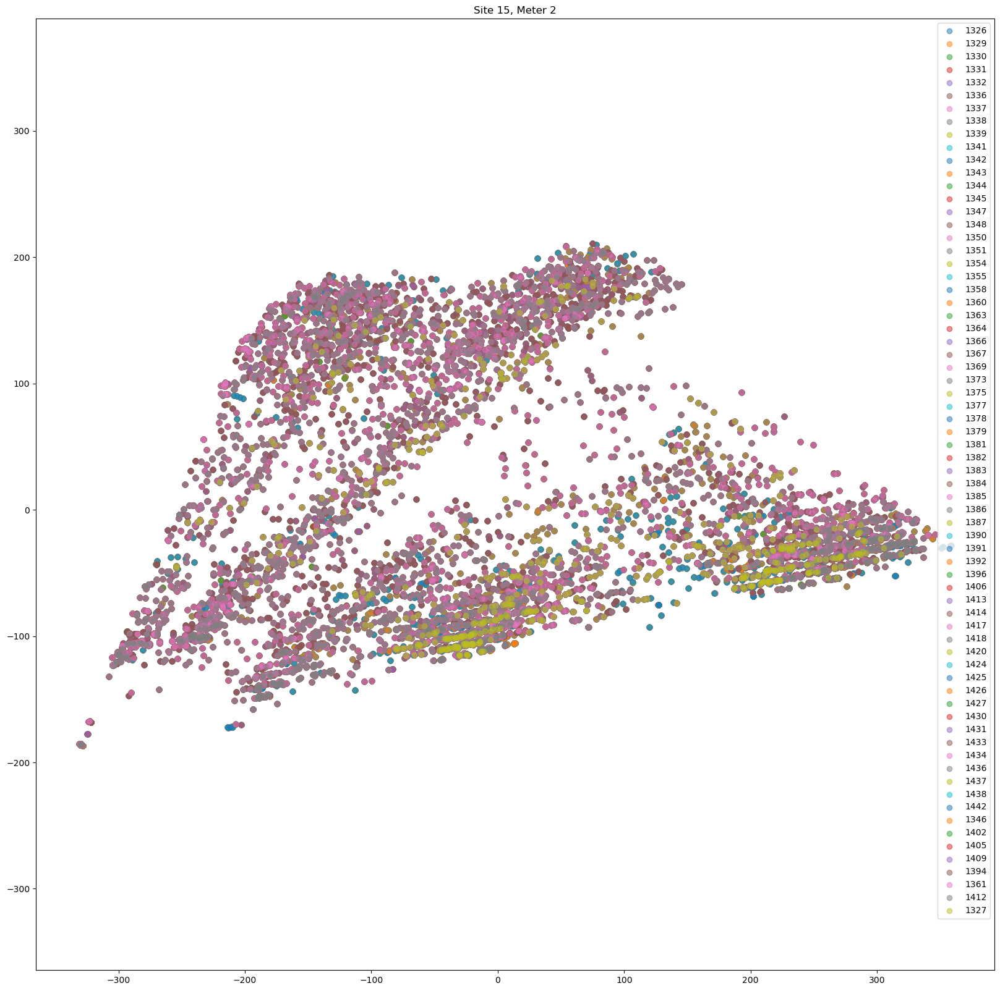

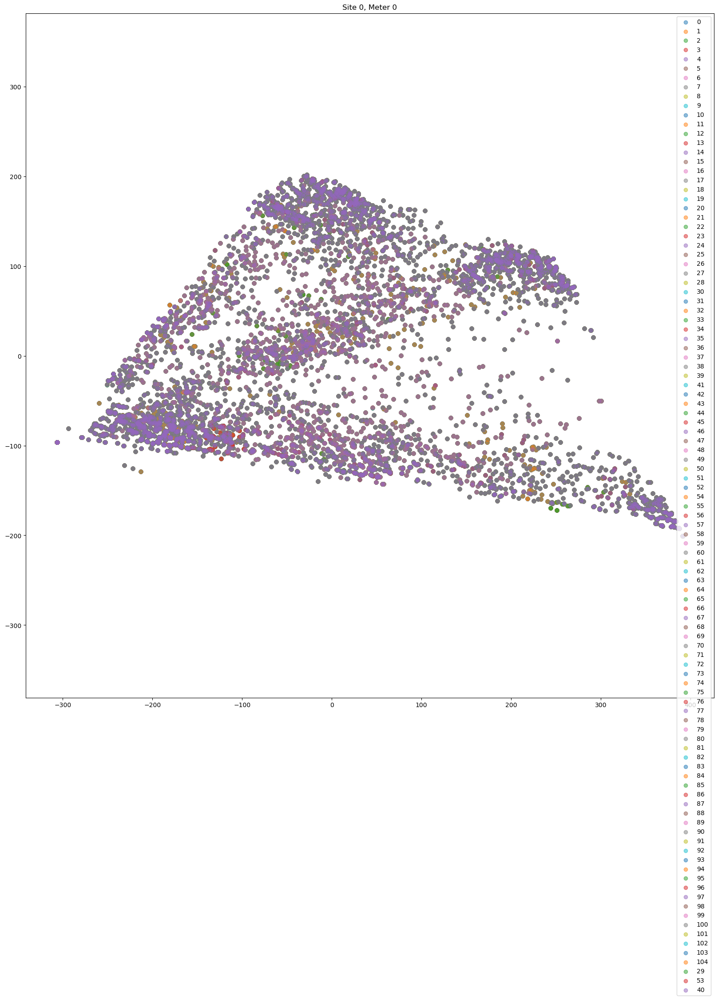

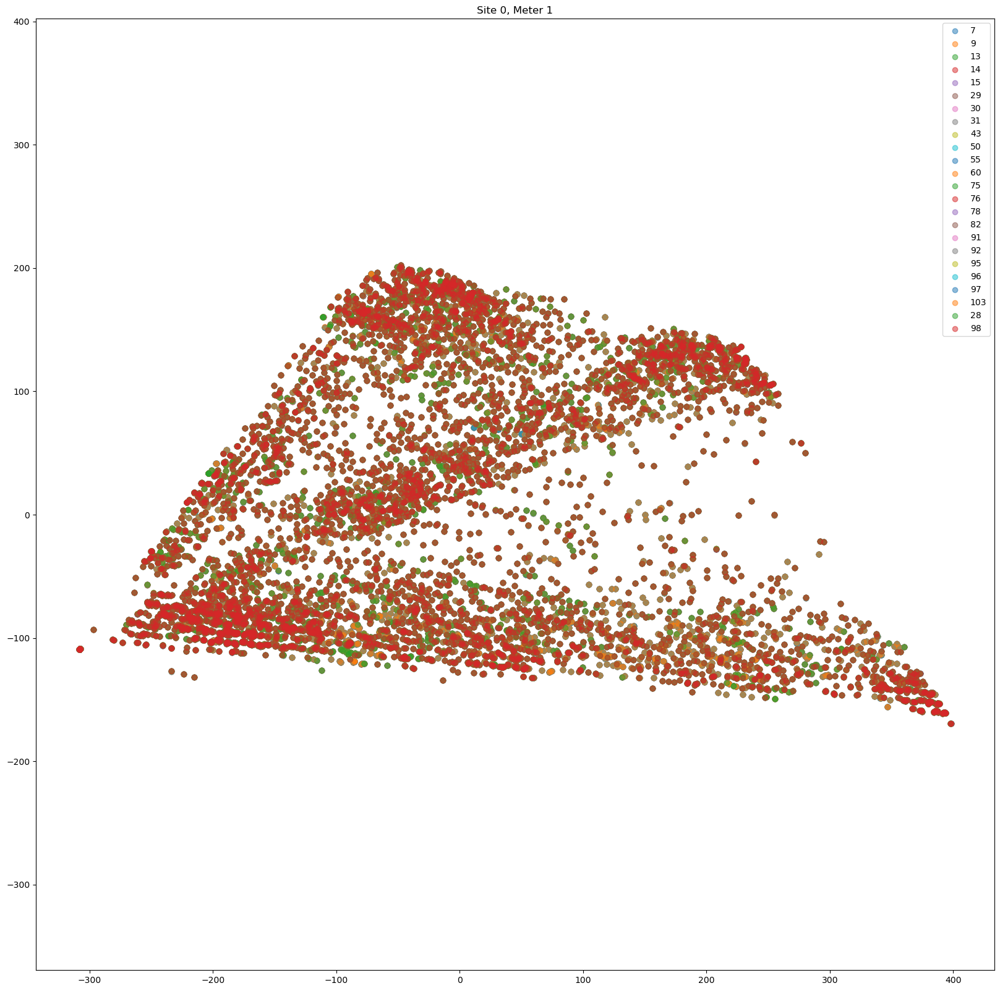

In [62]:
# Thought: what to do if no training data for a site? 
for site in data_dict['X_train']['site_id'].unique():
    for meter in data_dict['X_train']['meter'].unique():
        
        model = PCA(2)
        scaler = StandardScaler()
        query = (data_dict['X_train']['site_id'] == site) & (data_dict['X_train']['meter'] == meter)
        data = data_dict['X_train'][query]
        data = data[~data[features + ['building_id']].isna().any(axis=1)]
        buildings = data['building_id']

        try:
#             data = scaler.fit_transform(data[features])
            data = data[features]
            transformed = model.fit_transform(data)
        except:
            continue 
            
        plt.figure(figsize=(20, 20))
        plt.title(f"Site {site}, Meter {meter}")
    
        for b in buildings.unique():
            to_plot = transformed[buildings == b]
            plt.scatter(to_plot[:, 0], to_plot[:, 1], alpha=0.5, label=str(b))
        
        plt.axis('equal')
        plt.legend(loc='upper right')
        plt.show()